<a href="https://colab.research.google.com/github/Oleksy1121/Car-damage-detection/blob/main/Faster%20R-CNN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Konfiguracja środowiska

Skrypt konfiguruje środowisko do korzystania z biblioteki Detectron2 poprzez instalację wymaganych zależności, takich jak pyyaml i odpowiednia wersja Detectron2 z repozytorium GitHub. Detectron2 służy do zadań związanych z widzeniem komputerowym, takich jak wykrywanie obiektów i segmentacja obrazów.

In [ ]:
# Install the necessary components
!pip install pyyaml==5.1 --quiet  # Installation of pyyaml 5.1

import torch  # Importing PyTorch library

# Retrieve the version of PyTorch and CUDA
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)  # Displaying versions

# Install Detectron2 from GitHub repository
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git' --quiet  # Installing Detectron2

# exit(0)  # Restart runtime if needed


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 2.1 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
torch:  2.4 ; cuda:  cu121
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 873.9 kB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.2/78.2 kB 1.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 5.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

Importowanie niezbędnych bibliotek

In [ ]:
# Basic setup
from detectron2.utils.logger import setup_logger  # Setup detectron2 logger
setup_logger()

# Import common libraries
import numpy as np
import pandas as pd
import os, random, glob
import io
import time
import datetime
import logging
import json
import torch
import cv2

# Import visualization libraries
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab.patches import cv2_imshow

# Import additional libraries
from sklearn.metrics import confusion_matrix
from torch.utils.tensorboard import SummaryWriter
from tqdm import tqdm
import albumentations as A
from pycocotools import mask as maskUtils

# Import detectron2 utilities
import detectron2.utils.comm as comm
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor, DefaultTrainer, HookBase
from detectron2.config import get_cfg
from detectron2.utils.logger import log_every_n_seconds
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog, DatasetCatalog, DatasetMapper, build_detection_test_loader
from detectron2.data.datasets import register_coco_instances
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.structures import Boxes, pairwise_iou

/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:13: UserWarning: A new version of Albumentations is available: 1.4.16 (you have 1.4.15). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


# Ładowanie i rejestracja danych:

Pobieranie i rozpakowywanie zestawu danych z Roboflow

In [ ]:
# Download the dataset and unzip it
!curl -L "https://app.roboflow.com/ds/yjGLZlonKb?key=1qQLR6j7yT" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip  # Download and extract dataset

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   902  100   902    0     0   3906      0 --:--:-- --:--:-- --:--:--  3921
100 17.1M  100 17.1M    0     0  30.2M      0 --:--:-- --:--:-- --:--:-- 30.2M
Archive:  roboflow.zip
  inflating: README.dataset.txt      
  inflating: README.roboflow.txt     
   creating: test/
 extracting: test/07-is-250-came-to-my-car-saw-a-big-crack-in-the-rear-v0-epzwgdws1iaa1_webp.rf.f8fa8c1e25c320516c8be752fc2c6fbe.jpg  
 extracting: test/073_jpg.rf.9fb7792655a0d1aeb80a19d88d2216c2.jpg  
 extracting: test/077_jpg.rf.27e0ff0931694f718ff9ce851b1a7ae9.jpg  
 extracting: test/1150_jpg.rf.e2a4e07bcca74f8c0a698a4181be1d18.jpg  
 extracting: test/116260-IMG_9532_JPG_jpg.rf.ca2bf7ea5490c16f6a5284e5640de9e3.jpg  
 extracting: test/20240608_211701_jpg.rf.da44c321c5b85e16abc4728ea4b0a7d6.jpg  
 extracting: test/272_6_jpg.rf.ef48bd636a977979813113759191e08

Odczyt kategorii

In [ ]:
def check_category_names(path):
# Load the annotations file
  with open(path) as f:
      annotations = json.load(f)

  # Extract the categories
  categories = annotations['categories']

  # Display the category ids and names
  for category in categories:
      print(f"Category ID: {category['id']}, Name: {category['name']}")

check_category_names("/content/test/_annotations.coco.json")

Category ID: 0, Name: car-paint-damage-dent
Category ID: 1, Name: Crack
Category ID: 2, Name: Dent
Category ID: 3, Name: PDR-Dent
Category ID: 4, Name: Paint-Crack
Category ID: 5, Name: Paint-fading
Category ID: 6, Name: Rust
Category ID: 7, Name: Scratch


Aktualizacja kategorii aby były zgodne z wymaganym formatem

In [ ]:
# Lista folderów, w których dokonamy zmian
folders = ["/content/test", "/content/train", "/content/valid"]

# Nazwa pliku JSON w każdym folderze
file_name = "_annotations.coco.json"

def update_json_file(file_path):
    with open(file_path, 'r') as f:
        data = json.load(f)

    # Usunięcie kategorii z id 0
    data['categories'] = [category for category in data['categories'] if category['id'] != 0]

    # Usunięcie anotacji z id 0
    data['annotations'] = [annotation for annotation in data['annotations'] if annotation['category_id'] != 0]

    # Sortowanie kategorii według identyfikatorów
    data['categories'].sort(key=lambda x: x['id'])

    # Zapisanie zaktualizowanego pliku JSON
    with open(file_path, 'w') as f:
        json.dump(data, f, indent=4)

# Przejście przez każdy folder i aktualizacja plików JSON
for folder in folders:
    file_path = os.path.join(folder, file_name)
    update_json_file(file_path)
    print(f"Updated file: {file_path}")

print("All files updated.")


Updated file: /content/test/_annotations.coco.json
Updated file: /content/train/_annotations.coco.json
Updated file: /content/valid/_annotations.coco.json
All files updated.


In [ ]:
check_category_names("/content/test/_annotations.coco.json")

Category ID: 1, Name: Crack
Category ID: 2, Name: Dent
Category ID: 3, Name: PDR-Dent
Category ID: 4, Name: Paint-Crack
Category ID: 5, Name: Paint-fading
Category ID: 6, Name: Rust
Category ID: 7, Name: Scratch


Rejestrowanie tych danych jako instancji COCO do wykorzystania w Detectron2

In [ ]:
# Register COCO instances for training, testing, and validation datasets
register_coco_instances("my_dataset_train", {}, "/content/train/_annotations.coco.json", "/content/train")  # Register training dataset
register_coco_instances("my_dataset_test", {}, "/content/test/_annotations.coco.json", "/content/test")  # Register testing dataset
register_coco_instances("my_dataset_valid", {}, "/content/valid/_annotations.coco.json", "/content/valid")  # Register validation dataset

Wizualizacja losowych próbek

[09/24 16:52:32 d2.data.datasets.coco]: Loaded 342 images in COCO format from /content/train/_annotations.coco.json


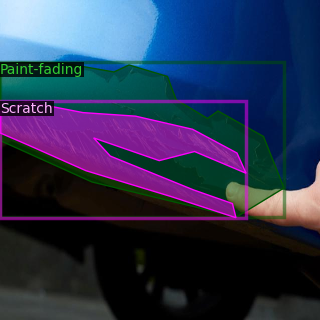

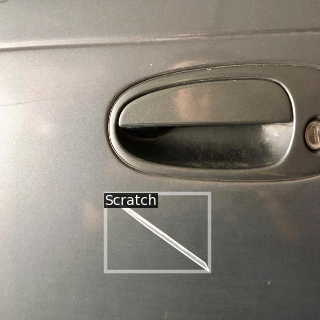

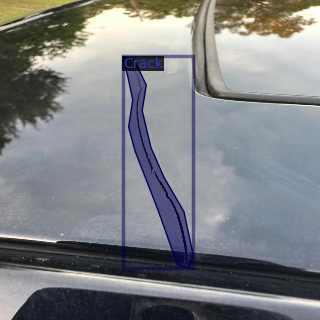

In [ ]:
# Visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

# Display random samples from the training dataset
for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])  # Show visualized image

# Konfiguracja i trenowanie modelu:
Skrypt konfiguruje model Faster R-CNN za pomocą biblioteki Detectron2, dostosowując kluczowe hiperparametry takie jak zestawy danych, liczba pracowników, współczynnik uczenia, liczba iteracji oraz liczba klas. Następnie model jest inicjalizowany i trenowany przy użyciu określonych ustawień, co umożliwia jego zastosowanie do zadania wykrywania obiektów.

In [ ]:
class LossEvalHook(HookBase):
    def __init__(self, eval_period, model, data_loader):
        self._model = model
        self._period = eval_period
        self._data_loader = data_loader

    def _do_loss_eval(self):
        total = len(self._data_loader)
        num_warmup = min(5, total - 1)
        start_time = time.perf_counter()
        total_compute_time = 0
        losses = []

        for idx, inputs in enumerate(self._data_loader):
            if idx == num_warmup:
                start_time = time.perf_counter()
                total_compute_time = 0
            start_compute_time = time.perf_counter()
            if torch.cuda.is_available():
                torch.cuda.synchronize()
            total_compute_time += time.perf_counter() - start_compute_time
            iters_after_start = idx + 1 - num_warmup * int(idx >= num_warmup)
            seconds_per_img = total_compute_time / iters_after_start
            if idx >= num_warmup * 2 or seconds_per_img > 5:
                total_seconds_per_img = (time.perf_counter() - start_time) / iters_after_start
                eta = datetime.timedelta(seconds=int(total_seconds_per_img * (total - idx - 1)))
                log_every_n_seconds(
                    logging.INFO,
                    "Loss on Validation done {}/{}. {:.4f} s / img. ETA={}".format(
                        idx + 1, total, seconds_per_img, str(eta)
                    ),
                    n=5,
                )
            loss_batch = self._get_loss(inputs)
            losses.append(loss_batch)

        mean_loss = np.mean(losses)
        self.trainer.storage.put_scalar('validation_loss', mean_loss)
        comm.synchronize()
        return mean_loss

    def _get_loss(self, data):
        metrics_dict = self._model(data)
        metrics_dict = {
            k: v.detach().cpu().item() if isinstance(v, torch.Tensor) else float(v)
            for k, v in metrics_dict.items()
        }
        total_losses_reduced = sum(loss for loss in metrics_dict.values())
        return total_losses_reduced

    def after_step(self):
        next_iter = self.trainer.iter + 1
        is_final = next_iter == self.trainer.max_iter
        if is_final or (self._period > 0 and next_iter % self._period == 0):
            mean_loss = self._do_loss_eval()
            self.trainer.storage.put_scalar('validation_loss', mean_loss)
        self.trainer.storage.put_scalars(timetest=12)


class EarlyStoppingHook(HookBase):
    def __init__(self, patience_iter, min_delta):
        self.patience_iter = patience_iter
        self.min_delta = min_delta
        self.best_loss = None
        self.best_iter = 0

    def after_step(self):
        current_iter = self.trainer.iter
        try:
            current_loss = self.trainer.storage.history("validation_loss").latest()
        except KeyError:
            # Jeśli nie ma jeszcze historii "validation_loss", zignoruj to
            return

        if self.best_loss is None or current_loss < self.best_loss - self.min_delta:
            self.best_loss = current_loss
            self.best_iter = current_iter
            # Zapisz najlepszy model
            self.trainer.checkpointer.save("best_model")
        elif current_iter - self.best_iter >= self.patience_iter:
            print("Early stopping triggered")
            self.trainer.storage.put_scalar("early_stopping", 1)
            raise Exception("Early stopping")


class MyTrainer(DefaultTrainer):
    @classmethod
    def build_evaluator(cls, cfg, dataset_name, output_folder=None):
        if output_folder is None:
            output_folder = os.path.join(cfg.OUTPUT_DIR, "inference")
        return COCOEvaluator(dataset_name, cfg, True, output_folder)

    def build_hooks(self):
        hooks = super().build_hooks()
        hooks.insert(-1, LossEvalHook(
            cfg.TEST.EVAL_PERIOD,
            self.model,
            build_detection_test_loader(
                self.cfg,
                self.cfg.DATASETS.TEST[0],
                DatasetMapper(self.cfg, True)
            )
        ))
        hooks.insert(-1, EarlyStoppingHook(patience_iter=500, min_delta=0.001))  # Early stopping hook
        return hooks

In [ ]:
# Configuration and training of the Faster R-CNN model

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))  # Load configuration for Faster R-CNN from model zoo
cfg.DATASETS.TRAIN = ("my_dataset_train",)  # Specify the training dataset
cfg.DATASETS.TEST = ("my_dataset_valid",)   # Specify the test dataset
cfg.TEST.EVAL_PERIOD = 100
cfg.DATALOADER.NUM_WORKERS = 8  # Set the number of data loading workers
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")  # Initialize model weights from the model zoo
cfg.SOLVER.IMS_PER_BATCH = 8  # Define the batch size as the number of images per batch
cfg.SOLVER.BASE_LR = 0.001  # Set the base learning rate for the solver
cfg.SOLVER.MAX_ITER = 2000  # Define the maximum number of iterations for training
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512  # Set the batch size per image for the ROI heads
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 7  # Specify the number of classes in the dataset

# Provide overfitting
#cfg.SOLVER.STEPS = (500,)
#cfg.SOLVER.GAMMA = 0.5


# Create the output directory if it does not already exist
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

# Train
trainer = MyTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[09/24 16:52:44 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_280758.pkl: 167MB [00:01, 133MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[09/24 16:52:45 d2.engine.train_loop]: Starting training from iteration 0


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/local/lib/python3.10/dist-packages/torch/functional.py:513: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3609.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[09/24 16:52:55 d2.utils.events]:  eta: 0:08:42  iter: 19  total_loss: 2.531  loss_cls: 2.204  loss_box_reg: 0.1154  loss_rpn_cls: 0.1675  loss_rpn_loc: 0.031    time: 0.2670  last_time: 0.2637  data_time: 0.0320  last_data_time: 0.0182   lr: 1.9981e-05  max_mem: 4968M
[09/24 16:53:01 d2.utils.events]:  eta: 0:08:37  iter: 39  total_loss: 1.976  loss_cls: 1.538  loss_box_reg: 0.1437  loss_rpn_cls: 0.1815  loss_rpn_loc: 0.02829    time: 0.2636  last_time: 0.2673  data_time: 0.0174  last_data_time: 0.0181   lr: 3.9961e-05  max_mem: 4968M
[09/24 16:53:06 d2.utils.events]:  eta: 0:08:31  iter: 59  total_loss: 0.9467  loss_cls: 0.5736  loss_box_reg: 0.112  loss_rpn_cls: 0.1961  loss_rpn_loc: 0.02586    time: 0.2630  last_time: 0.2560  data_time: 0.0169  last_data_time: 0.0179   lr: 5.9941e-05  max_mem: 4969M
[09/24 16:53:11 d2.utils.events]:  eta: 0:08:26  iter: 79  total_loss: 0.5656  loss_cls: 0.2889  loss_box_reg: 0.1517  loss_rpn_cls: 0.1029  loss_rpn_loc: 0.02389    time: 0.2633  last_

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:53:17 d2.evaluation.evaluator]: Inference done 11/69. Dataloading: 0.0005 s/iter. Inference: 0.0280 s/iter. Eval: 0.0002 s/iter. Total: 0.0288 s/iter. ETA=0:00:01
[09/24 16:53:19 d2.evaluation.evaluator]: Total inference time: 0:00:01.883348 (0.029427 s / iter per device, on 1 devices)
[09/24 16:53:19 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.027061 s / iter per device, on 1 devices)
[09/24 16:53:19 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[09/24 16:53:19 d2.evaluation.coco_evaluation]: Saving results to ./output/inference/coco_instances_results.json
[09/24 16:53:19 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[09/24 16:53:19 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[09/24 16:53:19 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.02 seconds.
[09/24 16:53:19 d2.e

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:53:20 detectron2]: Loss on Validation done 11/69. 0.0001 s / img. ETA=0:00:02
[09/24 16:53:23 d2.utils.events]:  eta: 0:08:20  iter: 99  total_loss: 0.5217  loss_cls: 0.2347  loss_box_reg: 0.1437  loss_rpn_cls: 0.08065  loss_rpn_loc: 0.01918  validation_loss: 0.4326    time: 0.2621  last_time: 0.2552  data_time: 0.0174  last_data_time: 0.0175   lr: 9.9901e-05  max_mem: 4969M
[09/24 16:53:28 d2.utils.events]:  eta: 0:08:11  iter: 119  total_loss: 0.5006  loss_cls: 0.2395  loss_box_reg: 0.1539  loss_rpn_cls: 0.07297  loss_rpn_loc: 0.02567  validation_loss: 0.4326    time: 0.2614  last_time: 0.2595  data_time: 0.0177  last_data_time: 0.0197   lr: 0.00011988  max_mem: 4969M
[09/24 16:53:33 d2.utils.events]:  eta: 0:08:04  iter: 139  total_loss: 0.4285  loss_cls: 0.2134  loss_box_reg: 0.1426  loss_rpn_cls: 0.05476  loss_rpn_loc: 0.02207  validation_loss: 0.4326    time: 0.2608  last_time: 0.2606  data_time: 0.0172  last_data_time: 0.0171   lr: 0.00013986  max_mem: 4969M
[09/24 16:

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:53:50 d2.evaluation.evaluator]: Inference done 11/69. Dataloading: 0.0007 s/iter. Inference: 0.0284 s/iter. Eval: 0.0003 s/iter. Total: 0.0294 s/iter. ETA=0:00:01


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:53:52 d2.evaluation.evaluator]: Total inference time: 0:00:01.836926 (0.028702 s / iter per device, on 1 devices)
[09/24 16:53:52 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.026311 s / iter per device, on 1 devices)
[09/24 16:53:52 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[09/24 16:53:52 d2.evaluation.coco_evaluation]: Saving results to ./output/inference/coco_instances_results.json
[09/24 16:53:52 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[09/24 16:53:52 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[09/24 16:53:52 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.02 seconds.
[09/24 16:53:52 d2.evaluation.fast_eval_api]: Accumulating evaluation results...
[09/24 16:53:52 d2.evaluation.fast_eval_api]: COCOeval_opt.accumulate() finished in 0.02 seconds.
 Average Preci

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:53:52 detectron2]: Loss on Validation done 11/69. 0.0001 s / img. ETA=0:00:01
[09/24 16:53:56 d2.utils.events]:  eta: 0:07:47  iter: 199  total_loss: 0.4254  loss_cls: 0.2246  loss_box_reg: 0.1457  loss_rpn_cls: 0.04413  loss_rpn_loc: 0.0228  validation_loss: 0.422    time: 0.2594  last_time: 0.2572  data_time: 0.0176  last_data_time: 0.0201   lr: 0.0001998  max_mem: 4969M
[09/24 16:54:02 d2.utils.events]:  eta: 0:07:42  iter: 219  total_loss: 0.4749  loss_cls: 0.2294  loss_box_reg: 0.1596  loss_rpn_cls: 0.04956  loss_rpn_loc: 0.02369  validation_loss: 0.422    time: 0.2594  last_time: 0.2661  data_time: 0.0186  last_data_time: 0.0208   lr: 0.00021978  max_mem: 4969M
[09/24 16:54:07 d2.utils.events]:  eta: 0:07:37  iter: 239  total_loss: 0.4877  loss_cls: 0.2262  loss_box_reg: 0.1717  loss_rpn_cls: 0.03747  loss_rpn_loc: 0.02467  validation_loss: 0.422    time: 0.2593  last_time: 0.2486  data_time: 0.0187  last_data_time: 0.0179   lr: 0.00023976  max_mem: 4969M
[09/24 16:54:1

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:54:23 d2.evaluation.evaluator]: Inference done 11/69. Dataloading: 0.0010 s/iter. Inference: 0.0275 s/iter. Eval: 0.0003 s/iter. Total: 0.0288 s/iter. ETA=0:00:01
[09/24 16:54:24 d2.evaluation.evaluator]: Total inference time: 0:00:01.798760 (0.028106 s / iter per device, on 1 devices)
[09/24 16:54:24 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.025745 s / iter per device, on 1 devices)
[09/24 16:54:24 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[09/24 16:54:24 d2.evaluation.coco_evaluation]: Saving results to ./output/inference/coco_instances_results.json
[09/24 16:54:24 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[09/24 16:54:25 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[09/24 16:54:25 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.02 seconds.
[09/24 16:54:25 d2.e

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:54:25 detectron2]: Loss on Validation done 11/69. 0.0001 s / img. ETA=0:00:01
[09/24 16:54:28 d2.utils.events]:  eta: 0:07:21  iter: 299  total_loss: 0.4702  loss_cls: 0.2159  loss_box_reg: 0.1744  loss_rpn_cls: 0.03858  loss_rpn_loc: 0.02574  validation_loss: 0.4415    time: 0.2590  last_time: 0.2623  data_time: 0.0181  last_data_time: 0.0185   lr: 0.0002997  max_mem: 4969M
[09/24 16:54:33 d2.utils.events]:  eta: 0:07:15  iter: 319  total_loss: 0.4453  loss_cls: 0.2027  loss_box_reg: 0.1671  loss_rpn_cls: 0.03796  loss_rpn_loc: 0.02152  validation_loss: 0.4415    time: 0.2591  last_time: 0.2657  data_time: 0.0178  last_data_time: 0.0185   lr: 0.00031968  max_mem: 4969M
[09/24 16:54:38 d2.utils.events]:  eta: 0:07:10  iter: 339  total_loss: 0.4564  loss_cls: 0.2215  loss_box_reg: 0.1871  loss_rpn_cls: 0.03021  loss_rpn_loc: 0.02131  validation_loss: 0.4415    time: 0.2590  last_time: 0.2621  data_time: 0.0192  last_data_time: 0.0191   lr: 0.00033966  max_mem: 4969M
[09/24 16:

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:54:54 d2.evaluation.evaluator]: Inference done 11/69. Dataloading: 0.0010 s/iter. Inference: 0.0267 s/iter. Eval: 0.0003 s/iter. Total: 0.0280 s/iter. ETA=0:00:01
[09/24 16:54:56 d2.evaluation.evaluator]: Total inference time: 0:00:01.870420 (0.029225 s / iter per device, on 1 devices)
[09/24 16:54:56 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.026668 s / iter per device, on 1 devices)
[09/24 16:54:56 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[09/24 16:54:56 d2.evaluation.coco_evaluation]: Saving results to ./output/inference/coco_instances_results.json
[09/24 16:54:56 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[09/24 16:54:56 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[09/24 16:54:56 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.04 seconds.
[09/24 16:54:56 d2.e

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:54:57 detectron2]: Loss on Validation done 11/69. 0.0001 s / img. ETA=0:00:01
[09/24 16:54:59 d2.utils.events]:  eta: 0:06:55  iter: 399  total_loss: 0.4367  loss_cls: 0.206  loss_box_reg: 0.1784  loss_rpn_cls: 0.03174  loss_rpn_loc: 0.0159  validation_loss: 0.4332    time: 0.2589  last_time: 0.2575  data_time: 0.0194  last_data_time: 0.0200   lr: 0.0003996  max_mem: 4969M
[09/24 16:55:04 d2.utils.events]:  eta: 0:06:50  iter: 419  total_loss: 0.4403  loss_cls: 0.2226  loss_box_reg: 0.1751  loss_rpn_cls: 0.02856  loss_rpn_loc: 0.02655  validation_loss: 0.4332    time: 0.2589  last_time: 0.2584  data_time: 0.0189  last_data_time: 0.0183   lr: 0.00041958  max_mem: 4969M
[09/24 16:55:10 d2.utils.events]:  eta: 0:06:44  iter: 439  total_loss: 0.4314  loss_cls: 0.2093  loss_box_reg: 0.1871  loss_rpn_cls: 0.0255  loss_rpn_loc: 0.01657  validation_loss: 0.4332    time: 0.2590  last_time: 0.2635  data_time: 0.0181  last_data_time: 0.0173   lr: 0.00043956  max_mem: 4969M
[09/24 16:55:

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:55:26 d2.evaluation.evaluator]: Inference done 11/69. Dataloading: 0.0011 s/iter. Inference: 0.0268 s/iter. Eval: 0.0004 s/iter. Total: 0.0282 s/iter. ETA=0:00:01


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:55:28 d2.evaluation.evaluator]: Total inference time: 0:00:01.891584 (0.029556 s / iter per device, on 1 devices)
[09/24 16:55:28 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.026947 s / iter per device, on 1 devices)
[09/24 16:55:28 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[09/24 16:55:28 d2.evaluation.coco_evaluation]: Saving results to ./output/inference/coco_instances_results.json
[09/24 16:55:28 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[09/24 16:55:28 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[09/24 16:55:28 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.03 seconds.
[09/24 16:55:28 d2.evaluation.fast_eval_api]: Accumulating evaluation results...
[09/24 16:55:28 d2.evaluation.fast_eval_api]: COCOeval_opt.accumulate() finished in 0.02 seconds.
 Average Preci

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:55:29 detectron2]: Loss on Validation done 11/69. 0.0001 s / img. ETA=0:00:01
[09/24 16:55:31 d2.utils.events]:  eta: 0:06:29  iter: 499  total_loss: 0.4332  loss_cls: 0.2086  loss_box_reg: 0.1822  loss_rpn_cls: 0.02361  loss_rpn_loc: 0.01764  validation_loss: 0.4294    time: 0.2592  last_time: 0.2667  data_time: 0.0194  last_data_time: 0.0156   lr: 0.0004995  max_mem: 4969M
[09/24 16:55:36 d2.utils.events]:  eta: 0:06:24  iter: 519  total_loss: 0.4711  loss_cls: 0.213  loss_box_reg: 0.2023  loss_rpn_cls: 0.02573  loss_rpn_loc: 0.01626  validation_loss: 0.4294    time: 0.2590  last_time: 0.2596  data_time: 0.0169  last_data_time: 0.0150   lr: 0.00051948  max_mem: 4969M
[09/24 16:55:41 d2.utils.events]:  eta: 0:06:18  iter: 539  total_loss: 0.4294  loss_cls: 0.1933  loss_box_reg: 0.1768  loss_rpn_cls: 0.01954  loss_rpn_loc: 0.01713  validation_loss: 0.4294    time: 0.2591  last_time: 0.2457  data_time: 0.0190  last_data_time: 0.0199   lr: 0.00053946  max_mem: 4969M
[09/24 16:5

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:55:57 d2.evaluation.evaluator]: Inference done 11/69. Dataloading: 0.0013 s/iter. Inference: 0.0272 s/iter. Eval: 0.0004 s/iter. Total: 0.0289 s/iter. ETA=0:00:01
[09/24 16:55:59 d2.evaluation.evaluator]: Total inference time: 0:00:01.857493 (0.029023 s / iter per device, on 1 devices)
[09/24 16:55:59 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.026447 s / iter per device, on 1 devices)
[09/24 16:55:59 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[09/24 16:55:59 d2.evaluation.coco_evaluation]: Saving results to ./output/inference/coco_instances_results.json
[09/24 16:55:59 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[09/24 16:55:59 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[09/24 16:55:59 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.45 seconds.
[09/24 16:55:59 d2.e

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:56:00 detectron2]: Loss on Validation done 11/69. 0.0001 s / img. ETA=0:00:01
[09/24 16:56:04 d2.utils.events]:  eta: 0:06:03  iter: 599  total_loss: 0.4071  loss_cls: 0.187  loss_box_reg: 0.1928  loss_rpn_cls: 0.02149  loss_rpn_loc: 0.01589  validation_loss: 0.4124    time: 0.2588  last_time: 0.2508  data_time: 0.0189  last_data_time: 0.0235   lr: 0.0005994  max_mem: 4969M
[09/24 16:56:10 d2.utils.events]:  eta: 0:05:58  iter: 619  total_loss: 0.4802  loss_cls: 0.2153  loss_box_reg: 0.2049  loss_rpn_cls: 0.01784  loss_rpn_loc: 0.01758  validation_loss: 0.4124    time: 0.2588  last_time: 0.2446  data_time: 0.0174  last_data_time: 0.0185   lr: 0.00061938  max_mem: 4969M
[09/24 16:56:15 d2.utils.events]:  eta: 0:05:52  iter: 639  total_loss: 0.439  loss_cls: 0.1953  loss_box_reg: 0.1854  loss_rpn_cls: 0.01811  loss_rpn_loc: 0.02299  validation_loss: 0.4124    time: 0.2588  last_time: 0.2615  data_time: 0.0181  last_data_time: 0.0187   lr: 0.00063936  max_mem: 4969M
[09/24 16:56

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:56:31 d2.evaluation.evaluator]: Inference done 11/69. Dataloading: 0.0012 s/iter. Inference: 0.0290 s/iter. Eval: 0.0004 s/iter. Total: 0.0306 s/iter. ETA=0:00:01
[09/24 16:56:33 d2.evaluation.evaluator]: Total inference time: 0:00:01.953847 (0.030529 s / iter per device, on 1 devices)
[09/24 16:56:33 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.027941 s / iter per device, on 1 devices)
[09/24 16:56:33 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[09/24 16:56:33 d2.evaluation.coco_evaluation]: Saving results to ./output/inference/coco_instances_results.json
[09/24 16:56:33 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[09/24 16:56:33 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[09/24 16:56:33 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.03 seconds.
[09/24 16:56:33 d2.e

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:56:34 detectron2]: Loss on Validation done 11/69. 0.0001 s / img. ETA=0:00:01
[09/24 16:56:37 d2.utils.events]:  eta: 0:05:37  iter: 699  total_loss: 0.4361  loss_cls: 0.2012  loss_box_reg: 0.2017  loss_rpn_cls: 0.01613  loss_rpn_loc: 0.0252  validation_loss: 0.3779    time: 0.2586  last_time: 0.2527  data_time: 0.0184  last_data_time: 0.0190   lr: 0.0006993  max_mem: 4969M
[09/24 16:56:43 d2.utils.events]:  eta: 0:05:31  iter: 719  total_loss: 0.3927  loss_cls: 0.165  loss_box_reg: 0.1696  loss_rpn_cls: 0.01527  loss_rpn_loc: 0.0133  validation_loss: 0.3779    time: 0.2585  last_time: 0.2627  data_time: 0.0174  last_data_time: 0.0176   lr: 0.00071928  max_mem: 4969M
[09/24 16:56:48 d2.utils.events]:  eta: 0:05:26  iter: 739  total_loss: 0.3728  loss_cls: 0.1774  loss_box_reg: 0.1716  loss_rpn_cls: 0.01183  loss_rpn_loc: 0.01369  validation_loss: 0.3779    time: 0.2586  last_time: 0.2618  data_time: 0.0180  last_data_time: 0.0156   lr: 0.00073926  max_mem: 4969M
[09/24 16:56:

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:57:04 d2.evaluation.evaluator]: Inference done 11/69. Dataloading: 0.0011 s/iter. Inference: 0.0264 s/iter. Eval: 0.0003 s/iter. Total: 0.0278 s/iter. ETA=0:00:01
[09/24 16:57:06 d2.evaluation.evaluator]: Total inference time: 0:00:01.818538 (0.028415 s / iter per device, on 1 devices)
[09/24 16:57:06 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.025965 s / iter per device, on 1 devices)
[09/24 16:57:06 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[09/24 16:57:06 d2.evaluation.coco_evaluation]: Saving results to ./output/inference/coco_instances_results.json
[09/24 16:57:06 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[09/24 16:57:06 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[09/24 16:57:06 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.03 seconds.
[09/24 16:57:06 d2.e

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:57:07 detectron2]: Loss on Validation done 11/69. 0.0001 s / img. ETA=0:00:01
[09/24 16:57:09 d2.utils.events]:  eta: 0:05:11  iter: 799  total_loss: 0.4015  loss_cls: 0.1678  loss_box_reg: 0.1878  loss_rpn_cls: 0.0123  loss_rpn_loc: 0.02188  validation_loss: 0.3964    time: 0.2585  last_time: 0.2524  data_time: 0.0178  last_data_time: 0.0159   lr: 0.0007992  max_mem: 4969M
[09/24 16:57:14 d2.utils.events]:  eta: 0:05:05  iter: 819  total_loss: 0.3303  loss_cls: 0.1462  loss_box_reg: 0.1492  loss_rpn_cls: 0.008752  loss_rpn_loc: 0.01261  validation_loss: 0.3964    time: 0.2585  last_time: 0.2633  data_time: 0.0180  last_data_time: 0.0157   lr: 0.00081918  max_mem: 4969M
[09/24 16:57:19 d2.utils.events]:  eta: 0:05:00  iter: 839  total_loss: 0.2988  loss_cls: 0.1345  loss_box_reg: 0.1342  loss_rpn_cls: 0.0104  loss_rpn_loc: 0.0152  validation_loss: 0.3964    time: 0.2585  last_time: 0.2621  data_time: 0.0173  last_data_time: 0.0148   lr: 0.00083916  max_mem: 4969M
[09/24 16:57

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:57:35 d2.evaluation.evaluator]: Inference done 11/69. Dataloading: 0.0014 s/iter. Inference: 0.0282 s/iter. Eval: 0.0003 s/iter. Total: 0.0299 s/iter. ETA=0:00:01
[09/24 16:57:37 d2.evaluation.evaluator]: Total inference time: 0:00:01.840638 (0.028760 s / iter per device, on 1 devices)
[09/24 16:57:37 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.026250 s / iter per device, on 1 devices)
[09/24 16:57:37 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[09/24 16:57:37 d2.evaluation.coco_evaluation]: Saving results to ./output/inference/coco_instances_results.json
[09/24 16:57:37 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[09/24 16:57:37 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[09/24 16:57:37 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.02 seconds.
[09/24 16:57:37 d2.e

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:57:38 detectron2]: Loss on Validation done 11/69. 0.0001 s / img. ETA=0:00:01
[09/24 16:57:41 d2.utils.events]:  eta: 0:04:45  iter: 899  total_loss: 0.3202  loss_cls: 0.141  loss_box_reg: 0.1494  loss_rpn_cls: 0.01014  loss_rpn_loc: 0.01549  validation_loss: 0.3532    time: 0.2584  last_time: 0.2660  data_time: 0.0175  last_data_time: 0.0165   lr: 0.0008991  max_mem: 4969M
[09/24 16:57:46 d2.utils.events]:  eta: 0:04:39  iter: 919  total_loss: 0.3291  loss_cls: 0.1483  loss_box_reg: 0.1483  loss_rpn_cls: 0.00701  loss_rpn_loc: 0.01748  validation_loss: 0.3532    time: 0.2584  last_time: 0.2558  data_time: 0.0182  last_data_time: 0.0174   lr: 0.00091908  max_mem: 4969M
[09/24 16:57:51 d2.utils.events]:  eta: 0:04:34  iter: 939  total_loss: 0.3068  loss_cls: 0.1309  loss_box_reg: 0.1536  loss_rpn_cls: 0.008638  loss_rpn_loc: 0.01426  validation_loss: 0.3532    time: 0.2584  last_time: 0.2567  data_time: 0.0175  last_data_time: 0.0191   lr: 0.00093906  max_mem: 4969M
[09/24 16:

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:58:08 d2.evaluation.evaluator]: Inference done 11/69. Dataloading: 0.0011 s/iter. Inference: 0.0265 s/iter. Eval: 0.0003 s/iter. Total: 0.0280 s/iter. ETA=0:00:01
[09/24 16:58:10 d2.evaluation.evaluator]: Total inference time: 0:00:01.853272 (0.028957 s / iter per device, on 1 devices)
[09/24 16:58:10 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.026445 s / iter per device, on 1 devices)
[09/24 16:58:10 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[09/24 16:58:10 d2.evaluation.coco_evaluation]: Saving results to ./output/inference/coco_instances_results.json
[09/24 16:58:10 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[09/24 16:58:10 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[09/24 16:58:10 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.02 seconds.
[09/24 16:58:10 d2.e

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:58:11 detectron2]: Loss on Validation done 11/69. 0.0001 s / img. ETA=0:00:01
[09/24 16:58:14 d2.utils.events]:  eta: 0:04:19  iter: 999  total_loss: 0.3027  loss_cls: 0.1303  loss_box_reg: 0.1346  loss_rpn_cls: 0.006512  loss_rpn_loc: 0.01556  validation_loss: 0.3499    time: 0.2583  last_time: 0.2684  data_time: 0.0182  last_data_time: 0.0199   lr: 0.000999  max_mem: 4969M
[09/24 16:58:20 d2.utils.events]:  eta: 0:04:13  iter: 1019  total_loss: 0.3194  loss_cls: 0.1356  loss_box_reg: 0.1474  loss_rpn_cls: 0.00694  loss_rpn_loc: 0.01703  validation_loss: 0.3499    time: 0.2584  last_time: 0.2630  data_time: 0.0184  last_data_time: 0.0176   lr: 0.001  max_mem: 4969M
[09/24 16:58:25 d2.utils.events]:  eta: 0:04:08  iter: 1039  total_loss: 0.296  loss_cls: 0.1206  loss_box_reg: 0.1452  loss_rpn_cls: 0.005777  loss_rpn_loc: 0.01532  validation_loss: 0.3499    time: 0.2585  last_time: 0.2635  data_time: 0.0174  last_data_time: 0.0187   lr: 0.001  max_mem: 4969M
[09/24 16:58:30 d2

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:58:42 d2.evaluation.evaluator]: Inference done 11/69. Dataloading: 0.0013 s/iter. Inference: 0.0261 s/iter. Eval: 0.0003 s/iter. Total: 0.0276 s/iter. ETA=0:00:01
[09/24 16:58:43 d2.evaluation.evaluator]: Total inference time: 0:00:01.821510 (0.028461 s / iter per device, on 1 devices)
[09/24 16:58:43 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.025946 s / iter per device, on 1 devices)
[09/24 16:58:43 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[09/24 16:58:43 d2.evaluation.coco_evaluation]: Saving results to ./output/inference/coco_instances_results.json
[09/24 16:58:43 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[09/24 16:58:43 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[09/24 16:58:43 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.02 seconds.
[09/24 16:58:43 d2.e

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:58:44 detectron2]: Loss on Validation done 11/69. 0.0001 s / img. ETA=0:00:01
[09/24 16:58:47 d2.utils.events]:  eta: 0:03:53  iter: 1099  total_loss: 0.273  loss_cls: 0.1247  loss_box_reg: 0.1389  loss_rpn_cls: 0.004489  loss_rpn_loc: 0.01466  validation_loss: 0.3837    time: 0.2586  last_time: 0.2593  data_time: 0.0188  last_data_time: 0.0153   lr: 0.001  max_mem: 4969M
[09/24 16:58:52 d2.utils.events]:  eta: 0:03:48  iter: 1119  total_loss: 0.2575  loss_cls: 0.09768  loss_box_reg: 0.1299  loss_rpn_cls: 0.004235  loss_rpn_loc: 0.01317  validation_loss: 0.3837    time: 0.2587  last_time: 0.2652  data_time: 0.0185  last_data_time: 0.0186   lr: 0.001  max_mem: 4969M
[09/24 16:58:57 d2.utils.events]:  eta: 0:03:42  iter: 1139  total_loss: 0.2928  loss_cls: 0.115  loss_box_reg: 0.1465  loss_rpn_cls: 0.006296  loss_rpn_loc: 0.01774  validation_loss: 0.3837    time: 0.2587  last_time: 0.2653  data_time: 0.0183  last_data_time: 0.0209   lr: 0.001  max_mem: 4969M
[09/24 16:59:02 d2.

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:59:13 d2.evaluation.evaluator]: Inference done 11/69. Dataloading: 0.0011 s/iter. Inference: 0.0274 s/iter. Eval: 0.0003 s/iter. Total: 0.0288 s/iter. ETA=0:00:01
[09/24 16:59:15 d2.evaluation.evaluator]: Total inference time: 0:00:01.843165 (0.028799 s / iter per device, on 1 devices)
[09/24 16:59:15 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.026314 s / iter per device, on 1 devices)
[09/24 16:59:15 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[09/24 16:59:15 d2.evaluation.coco_evaluation]: Saving results to ./output/inference/coco_instances_results.json
[09/24 16:59:15 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[09/24 16:59:15 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[09/24 16:59:15 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.02 seconds.
[09/24 16:59:15 d2.e

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:59:16 detectron2]: Loss on Validation done 11/69. 0.0001 s / img. ETA=0:00:01
[09/24 16:59:18 d2.utils.events]:  eta: 0:03:27  iter: 1199  total_loss: 0.2306  loss_cls: 0.09312  loss_box_reg: 0.1168  loss_rpn_cls: 0.005933  loss_rpn_loc: 0.01318  validation_loss: 0.4033    time: 0.2588  last_time: 0.2635  data_time: 0.0190  last_data_time: 0.0205   lr: 0.001  max_mem: 4969M
[09/24 16:59:23 d2.utils.events]:  eta: 0:03:22  iter: 1219  total_loss: 0.221  loss_cls: 0.09371  loss_box_reg: 0.1179  loss_rpn_cls: 0.002836  loss_rpn_loc: 0.01425  validation_loss: 0.4033    time: 0.2587  last_time: 0.2600  data_time: 0.0175  last_data_time: 0.0174   lr: 0.001  max_mem: 4969M
[09/24 16:59:29 d2.utils.events]:  eta: 0:03:17  iter: 1239  total_loss: 0.2481  loss_cls: 0.1063  loss_box_reg: 0.1273  loss_rpn_cls: 0.00496  loss_rpn_loc: 0.01402  validation_loss: 0.4033    time: 0.2587  last_time: 0.2567  data_time: 0.0173  last_data_time: 0.0181   lr: 0.001  max_mem: 4969M
[09/24 16:59:34 d2

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:59:45 d2.evaluation.evaluator]: Inference done 11/69. Dataloading: 0.0013 s/iter. Inference: 0.0262 s/iter. Eval: 0.0003 s/iter. Total: 0.0278 s/iter. ETA=0:00:01
[09/24 16:59:46 d2.evaluation.evaluator]: Total inference time: 0:00:01.859879 (0.029061 s / iter per device, on 1 devices)
[09/24 16:59:46 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.026558 s / iter per device, on 1 devices)
[09/24 16:59:46 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[09/24 16:59:46 d2.evaluation.coco_evaluation]: Saving results to ./output/inference/coco_instances_results.json
[09/24 16:59:46 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[09/24 16:59:46 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[09/24 16:59:46 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.02 seconds.
[09/24 16:59:46 d2.e

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 16:59:47 detectron2]: Loss on Validation done 11/69. 0.0001 s / img. ETA=0:00:01
[09/24 16:59:50 d2.utils.events]:  eta: 0:03:01  iter: 1299  total_loss: 0.2592  loss_cls: 0.09666  loss_box_reg: 0.1414  loss_rpn_cls: 0.003114  loss_rpn_loc: 0.01538  validation_loss: 0.4438    time: 0.2587  last_time: 0.2623  data_time: 0.0178  last_data_time: 0.0180   lr: 0.001  max_mem: 4969M
[09/24 16:59:55 d2.utils.events]:  eta: 0:02:56  iter: 1319  total_loss: 0.2186  loss_cls: 0.08768  loss_box_reg: 0.1121  loss_rpn_cls: 0.00362  loss_rpn_loc: 0.009516  validation_loss: 0.4438    time: 0.2587  last_time: 0.2617  data_time: 0.0176  last_data_time: 0.0193   lr: 0.001  max_mem: 4969M
[09/24 17:00:00 d2.utils.events]:  eta: 0:02:51  iter: 1339  total_loss: 0.2418  loss_cls: 0.08523  loss_box_reg: 0.13  loss_rpn_cls: 0.003662  loss_rpn_loc: 0.01574  validation_loss: 0.4438    time: 0.2587  last_time: 0.2404  data_time: 0.0191  last_data_time: 0.0176   lr: 0.001  max_mem: 4969M
[09/24 17:00:05 d

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 17:00:16 d2.evaluation.evaluator]: Inference done 11/69. Dataloading: 0.0011 s/iter. Inference: 0.0264 s/iter. Eval: 0.0003 s/iter. Total: 0.0278 s/iter. ETA=0:00:01
[09/24 17:00:18 d2.evaluation.evaluator]: Total inference time: 0:00:01.830542 (0.028602 s / iter per device, on 1 devices)
[09/24 17:00:18 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.026164 s / iter per device, on 1 devices)
[09/24 17:00:18 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[09/24 17:00:18 d2.evaluation.coco_evaluation]: Saving results to ./output/inference/coco_instances_results.json
[09/24 17:00:18 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[09/24 17:00:18 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[09/24 17:00:18 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.02 seconds.
[09/24 17:00:18 d2.e

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 17:00:19 detectron2]: Loss on Validation done 11/69. 0.0001 s / img. ETA=0:00:02
[09/24 17:00:21 d2.utils.events]:  eta: 0:02:35  iter: 1399  total_loss: 0.2304  loss_cls: 0.09188  loss_box_reg: 0.1218  loss_rpn_cls: 0.002051  loss_rpn_loc: 0.01001  validation_loss: 0.3945    time: 0.2586  last_time: 0.2581  data_time: 0.0184  last_data_time: 0.0165   lr: 0.001  max_mem: 4969M
[09/24 17:00:26 d2.utils.events]:  eta: 0:02:30  iter: 1419  total_loss: 0.2298  loss_cls: 0.08708  loss_box_reg: 0.1308  loss_rpn_cls: 0.002704  loss_rpn_loc: 0.01492  validation_loss: 0.3945    time: 0.2587  last_time: 0.2601  data_time: 0.0186  last_data_time: 0.0192   lr: 0.001  max_mem: 4969M
[09/24 17:00:31 d2.utils.events]:  eta: 0:02:25  iter: 1439  total_loss: 0.2076  loss_cls: 0.07914  loss_box_reg: 0.1041  loss_rpn_cls: 0.00309  loss_rpn_loc: 0.01429  validation_loss: 0.3945    time: 0.2588  last_time: 0.2646  data_time: 0.0188  last_data_time: 0.0204   lr: 0.001  max_mem: 4969M
[09/24 17:00:37 

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 17:00:48 d2.evaluation.evaluator]: Inference done 11/69. Dataloading: 0.0011 s/iter. Inference: 0.0263 s/iter. Eval: 0.0003 s/iter. Total: 0.0277 s/iter. ETA=0:00:01
[09/24 17:00:49 d2.evaluation.evaluator]: Total inference time: 0:00:01.895426 (0.029616 s / iter per device, on 1 devices)
[09/24 17:00:49 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.027019 s / iter per device, on 1 devices)
[09/24 17:00:50 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[09/24 17:00:50 d2.evaluation.coco_evaluation]: Saving results to ./output/inference/coco_instances_results.json
[09/24 17:00:50 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[09/24 17:00:50 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[09/24 17:00:50 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.02 seconds.
[09/24 17:00:50 d2.e

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[09/24 17:00:50 detectron2]: Loss on Validation done 11/69. 0.0001 s / img. ETA=0:00:01
Early stopping triggered
ERROR [09/24 17:00:53 d2.engine.train_loop]: Exception during training:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/detectron2/engine/train_loop.py", line 156, in train
    self.after_step()
  File "/usr/local/lib/python3.10/dist-packages/detectron2/engine/train_loop.py", line 190, in after_step
    h.after_step()
  File "<ipython-input-9-a0bf174c0ff2>", line 83, in after_step
    raise Exception("Early stopping")
Exception: Early stopping
[09/24 17:00:53 d2.engine.hooks]: Overall training speed: 1497 iterations in 0:06:27 (0.2590 s / it)
[09/24 17:00:53 d2.engine.hooks]: Total training time: 0:08:02 (0:01:35 on hooks)
[09/24 17:00:53 d2.utils.events]:  eta: 0:02:09  iter: 1499  total_loss: 0.2057  loss_cls: 0.079  loss_box_reg: 0.1028  loss_rpn_cls: 0.002807  loss_rpn_loc: 0.01358  validation_loss: 0.4242    time: 0.2588  last_time: 0.

Exception: Early stopping

# Monitorowanie procesu uczenia
Skrypt uruchamia TensorBoard w celu wizualizacji wskaźników jakości, co umożliwia monitorowanie procesu uczenia modelu.

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

# Ewaluacja modelu:
Skrypt ładuje wytrenowane wagi modelu i konfiguruje próg dla testowania. Następnie przeprowadza predykcje na zbiorze testowym i wizualizuje wyniki.

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "best_model.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = ("my_dataset_test", )
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

[09/24 17:02:21 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/best_model.pth ...


/usr/local/lib/python3.10/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

Wizualizacja predykcji na zbiorze testowym

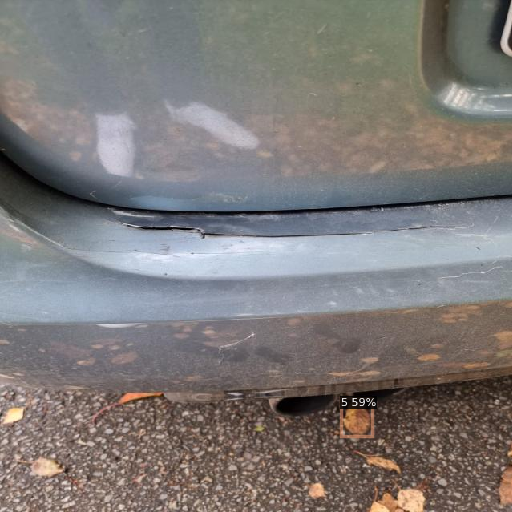

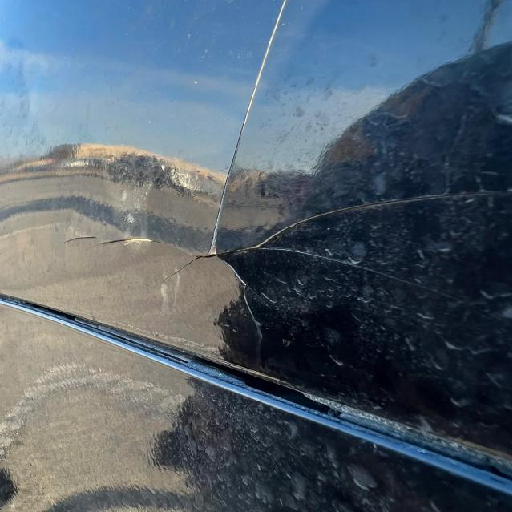

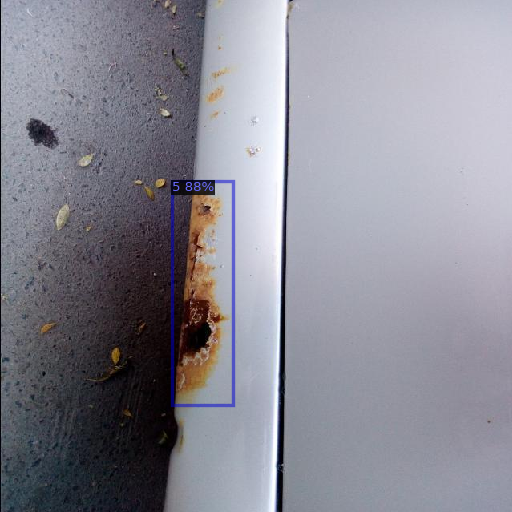

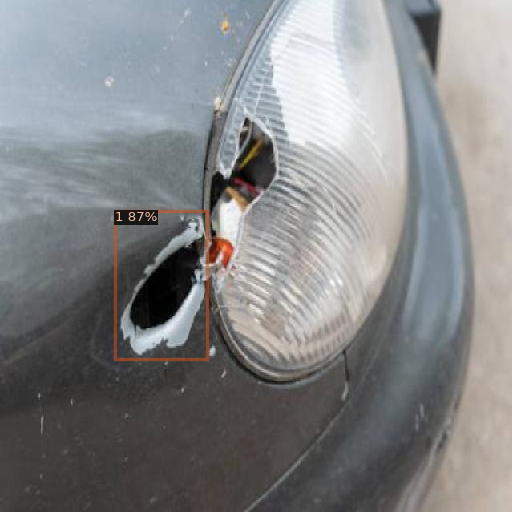

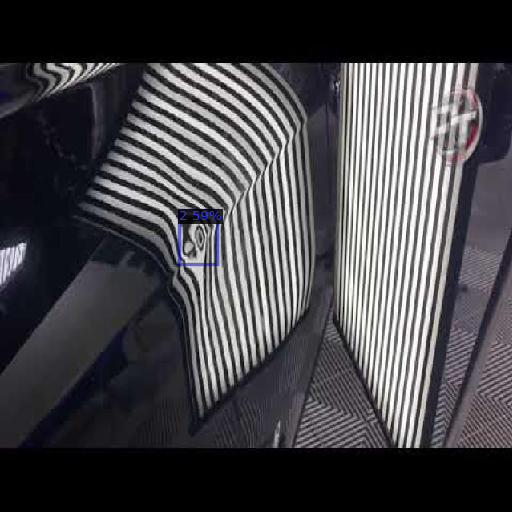

...

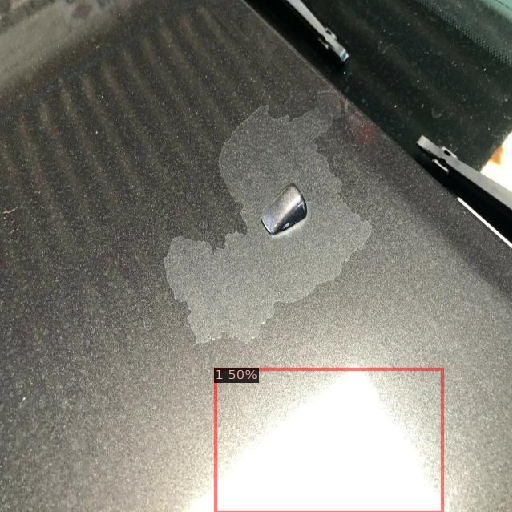

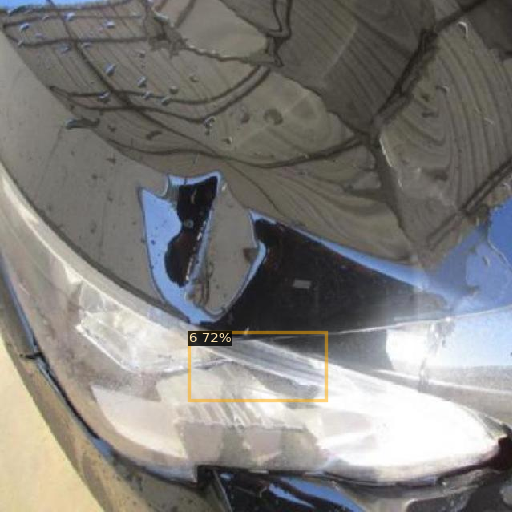

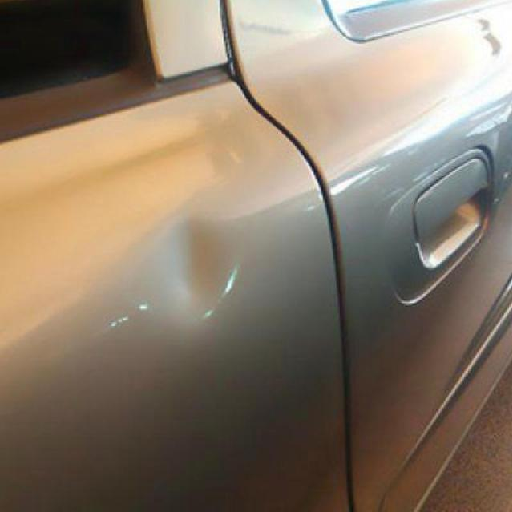

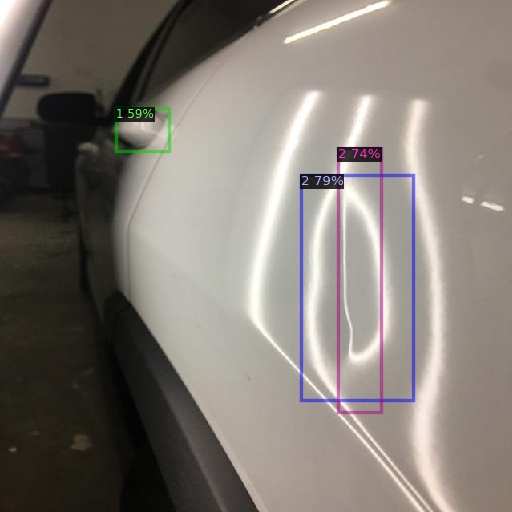

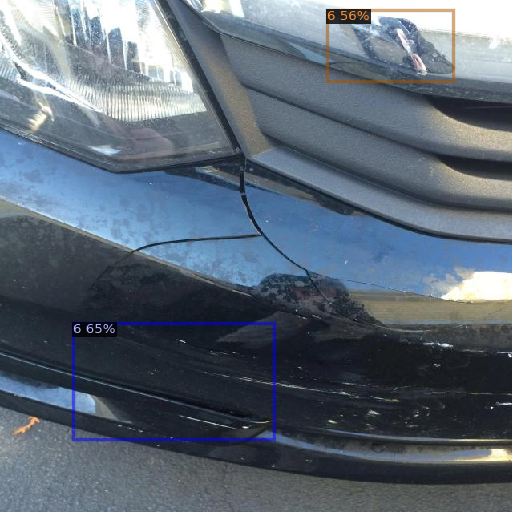

In [ ]:
for imageName in glob.glob('/content/test/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata,
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])

Ewaluacja modelu na zbiorze testowym przy użyciu COCOEvaluator,

# Obliczanie i wizualizacja macierzy pomyłek
Skrypt definiuje funkcje do obliczania macierzy pomyłek dla modelu wykrywania obiektów, a następnie konwertuje tę macierz do obrazu dla wizualizacji.

In [ ]:
import numpy as np
import pandas as pd
import torch
from detectron2.structures import Boxes, pairwise_iou
from detectron2.engine import DefaultPredictor
from detectron2.data import MetadataCatalog, DatasetCatalog
import cv2
import matplotlib.pyplot as plt
import seaborn as sns

def coco_bbox_to_coordinates(bbox):
    out = bbox.copy().astype(float)
    out[:, 2] = bbox[:, 0] + bbox[:, 2]
    out[:, 3] = bbox[:, 1] + bbox[:, 3]
    return out

def conf_matrix_calc(labels, detections, n_classes, conf_thresh, iou_thresh):
    if len(labels) == 0 or len(detections) == 0:
        return np.zeros([n_classes + 1, n_classes + 1])

    confusion_matrix = np.zeros([n_classes + 1, n_classes + 1])
    l_classes = np.array(labels)[:, 0].astype(int)
    l_bboxs = coco_bbox_to_coordinates(np.array(labels)[:, 1:])

    d_confs = np.array(detections)[:, 4]
    d_bboxs = np.array(detections)[:, :4]
    d_classes = np.array(detections)[:, -1].astype(int)

    detections = detections[d_confs > conf_thresh]
    labels_detected = np.zeros(len(labels))
    detections_matched = np.zeros(len(detections))

    for l_idx, (l_class, l_bbox) in enumerate(zip(l_classes, l_bboxs)):
        for d_idx, (d_bbox, d_class) in enumerate(zip(d_bboxs, d_classes)):
            iou = pairwise_iou(Boxes(torch.from_numpy(np.array([l_bbox]))), Boxes(torch.from_numpy(np.array([d_bbox]))))
            if iou >= iou_thresh:
                confusion_matrix[l_class, d_class] += 1
                labels_detected[l_idx] = 1
                detections_matched[d_idx] = 1

    for i in np.where(labels_detected == 0)[0]:
        confusion_matrix[l_classes[i], -1] += 1
    for i in np.where(detections_matched == 0)[0]:
        confusion_matrix[-1, d_classes[i]] += 1

    return confusion_matrix



dataset_dicts = DatasetCatalog.get("my_dataset_test")

n_classes = cfg.MODEL.ROI_HEADS.NUM_CLASSES
confusion_matrix = np.zeros([n_classes + 1, n_classes + 1])

for d in dataset_dicts:
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)
    labels = []
    detections = []

    for ann in d["annotations"]:
        labels.append([ann["category_id"]] + ann["bbox"])

    if len(outputs["instances"]) > 0:
        for coord, conf, cls in zip(
            outputs["instances"].pred_boxes.tensor.cpu().numpy(),
            outputs["instances"].scores.cpu().numpy(),
            outputs["instances"].pred_classes.cpu().numpy()
        ):
            detections.append(list(coord) + [conf] + [cls])

    confusion_matrix += conf_matrix_calc(np.array(labels), np.array(detections), n_classes, conf_thresh=0.5, iou_thresh=0.5)

# Normalize the confusion matrix
confusion_matrix_normalized = confusion_matrix.astype('float') / confusion_matrix.sum(axis=1)[:, np.newaxis]

class_names = test_metadata.get("thing_classes") + ["Background"]
matrix_df = pd.DataFrame(confusion_matrix_normalized, columns=class_names, index=class_names)


# Path to save the image
output_path = "/content/output"
os.makedirs(output_path, exist_ok=True)  # Ensure the directory exists

# Plotting the normalized confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(matrix_df, annot=True, fmt=".2f", cmap="Blues")
plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.title('Normalized Confusion Matrix')

# Save the plot as an image in the specified folder
plt.savefig(os.path.join(output_path, "confusion_matrix.png"))
plt.close()

[09/24 17:05:04 d2.data.datasets.coco]: Loaded 45 images in COCO format from /content/test/_annotations.coco.json


In [ ]:
# Zip the output directory
!zip -r /content/output.zip ./output


  adding: output/ (stored 0%)
  adding: output/inference/ (stored 0%)
  adding: output/inference/instances_predictions.pth (deflated 58%)
  adding: output/inference/coco_instances_results.json (deflated 71%)
  adding: output/confusion_matrix.png (deflated 14%)
  adding: output/last_checkpoint (stored 0%)
  adding: output/.ipynb_checkpoints/ (stored 0%)
  adding: output/events.out.tfevents.1720976216.8668dcef700d.1755.22 (deflated 71%)
  adding: output/metrics.json (deflated 76%)
  adding: output/events.out.tfevents.1720975110.8668dcef700d.1755.20 (deflated 71%)
  adding: output/best_model.pth (deflated 7%)
  adding: output/events.out.tfevents.1720976173.8668dcef700d.1755.21 (deflated 58%)
